<a href="https://colab.research.google.com/github/davidlevinwork/ArtGAN/blob/main/ArtGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **ArtGAN**: Art Style Transfer with Self-Attention Generative Adversarial Networks

### Installations


In [ ]:
pip install numpy opencv-python Pillow scikit-learn beautifulsoup4 requests tensorflow tensorflow-addons matplotlib

## Artist Image Dataset Creation

In [ ]:
import os
import cv2
import requests
import numpy as np
from PIL import Image
from io import BytesIO
from bs4 import BeautifulSoup
from sklearn.model_selection import train_test_split

# Configuration
ARTIST_NAMES = ["vincent-van-gogh", "pablo-picasso"]
WIKIART_URL = "https://www.wikiart.org/en/{}/all-works/text-list"
IMAGE_SIZE = 256
TEST_SPLIT = 0.2

def preprocess_image(image_url, size):
    # Retrieve image from URL
    response = requests.get(image_url)
    image = Image.open(BytesIO(response.content))
    
    # Convert the image to RGB format
    image = image.convert('RGB')
    
    # Resize the image
    image = image.resize((size, size), Image.ANTIALIAS)
    
    # Convert the image to a NumPy array
    image = np.asarray(image)
    
    # Normalize the image to [-1, 1]
    image = (image - 127.5) / 127.5
    return image

def get_image_links(artist_name, page):
    image_links = []
    
    # Retrieve artist's paintings page
    artist_url = WIKIART_URL.format(artist_name) + f'?json=2&page={page}'
    response = requests.get(artist_url)
    
    if response.status_code == 200:
        response_json = response.json()
        
        # Extract image URLs from the response
        for item in response_json["Paintings"]:
            image_links.append(item["image"])
            
    return image_links

def load_dataset(artist_name, max_pages=10):
    images = []
    
    # Iterate over each page
    for page in range(1, max_pages + 1):
        print(f"Retrieving images from {artist_name} - Page {page}")
        image_links = get_image_links(artist_name, page)
        
        if not image_links:
            break
            
        # Iterate over each image link
        for image_url in image_links:
            try:
                print(f"Processing image: {image_url}")
                image = preprocess_image(image_url, IMAGE_SIZE)
                images.append(image)
            except:
                print(f"Error processing image: {image_url}")
                pass

    return np.array(images)

# Load datasets
print("Loading Van Gogh dataset...")
van_gogh_dataset = load_dataset("vincent-van-gogh")
print("Loading Picasso dataset...")
picasso_dataset = load_dataset("pablo-picasso")

# Split datasets
vg_train, vg_test = train_test_split(van_gogh_dataset, test_size=TEST_SPLIT, random_state=42)
p_train, p_test = train_test_split(picasso_dataset, test_size=TEST_SPLIT, random_state=42)

print("Van Gogh - Train:", vg_train.shape, "Test:", vg_test.shape)
print("Picasso - Train:", p_train.shape, "Test:", p_test.shape)

## ArtGAN Architecture 

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

# Attention block for adding the self-attention mechanism
def attention_block(input_layer, filters):
    q = layers.Conv2D(filters, 1, padding='same')(input_layer)  # Query
    k = layers.Conv2D(filters, 1, padding='same')(input_layer)  # Key
    v = layers.Conv2D(filters, 1, padding='same')(input_layer)  # Value

    qk = layers.Multiply()([q, k])  # Element-wise multiplication of Query and Key
    qk = layers.Activation('softmax')(qk)  # Apply softmax to obtain attention weights

    attention = layers.Multiply()([v, qk])  # Element-wise multiplication of Value and attention weights

    output = layers.Add()([input_layer, attention])  # Add input and attention layers
    return output

# Define the generator network
def define_generator(is_attention, input_shape=(256, 256, 3)):
    input_layer = layers.Input(shape=input_shape)

    # Encoder
    enc1 = layers.Conv2D(64, 4, strides=2, padding='same')(input_layer)
    enc1 = layers.LeakyReLU(alpha=0.2)(enc1)

    enc2 = layers.Conv2D(128, 4, strides=2, padding='same')(enc1)
    enc2 = layers.BatchNormalization()(enc2)
    enc2 = layers.LeakyReLU(alpha=0.2)(enc2)

    enc3 = layers.Conv2D(256, 4, strides=2, padding='same')(enc2)
    enc3 = layers.BatchNormalization()(enc3)
    enc3 = layers.LeakyReLU(alpha=0.2)(enc3)

    # Bottleneck with attention mechanism
    bottleneck = layers.Conv2D(512, 4, strides=2, padding='same')(enc3)
    bottleneck = layers.BatchNormalization()(bottleneck)
    bottleneck = layers.LeakyReLU(alpha=0.2)(bottleneck)

    # Attention layer
    if is_attention:
      bottleneck = attention_block(bottleneck, 512)

    # Decoder
    dec1 = layers.Conv2DTranspose(256, 4, strides=2, padding='same')(bottleneck)
    dec1 = layers.BatchNormalization()(dec1)
    dec1 = layers.ReLU()(dec1)
    dec1 = layers.Concatenate()([dec1, enc3])

    dec2 = layers.Conv2DTranspose(128, 4, strides=2, padding='same')(dec1)
    dec2 = layers.BatchNormalization()(dec2)
    dec2 = layers.ReLU()(dec2)
    dec2 = layers.Concatenate()([dec2, enc2])

    dec3 = layers.Conv2DTranspose(64, 4, strides=2, padding='same')(dec2)
    dec3 = layers.BatchNormalization()(dec3)
    dec3 = layers.ReLU()(dec3)
    dec3 = layers.Concatenate()([dec3, enc1])

    output_layer = layers.Conv2DTranspose(3, 4, strides=2, padding='same', activation='tanh')(dec3)

    return tf.keras.Model(inputs=input_layer, outputs=output_layer)

# Define the discriminator network
def define_discriminator(input_shape=(256, 256, 3)):
    input_layer = layers.Input(shape=input_shape)

    x = layers.Conv2D(64, 4, strides=2, padding='same')(input_layer)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Conv2D(128, 4, strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Conv2D(256, 4, strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Conv2D(512, 4, strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Conv2D(1, 4, padding='same')(x)  # Output layer

    return tf.keras.Model(inputs=input_layer, outputs=x)

### ArtGAN Network Definition

In [ ]:
# ArtGAN generator and discriminator networks
g_AB = define_generator(is_attention=True)
g_BA = define_generator(is_attention=True)

d_A = define_discriminator()
d_B = define_discriminator()

### CycleGAN Network Definition

In [ ]:
# ArtGAN generator and discriminator networks
g_AB_n = define_generator(is_attention=False)
g_BA_n = define_generator(is_attention=False)

d_A_n = define_discriminator()
d_B_n = define_discriminator()

## Training the ArtGAN Model

### Loss Function Definitions

In [ ]:
import tensorflow_addons as tfa

# Loss functions
LAMBDA = 10  # Weight for cycle consistency loss
ALPHA = 0.5  # Weight for identity loss

# Binary cross-entropy loss for discriminator and generator loss functions
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# Discriminator loss function: it computes the average loss for real and generated images
def discriminator_loss(real, generated):
    real_loss = loss_object(tf.ones_like(real), real)  # Loss for real images
    generated_loss = loss_object(tf.zeros_like(generated), generated)  # Loss for generated images
    total_disc_loss = (real_loss + generated_loss) * 0.5  # Average loss
    return total_disc_loss

# Generator loss function: it aims to maximize the discriminator's error on generated images
def generator_loss(generated):
    return loss_object(tf.ones_like(generated), generated)

# Cycle consistency loss function: it computes the mean absolute error between the real and cycled images
def cycle_consistency_loss(real_image, cycled_image):
    return tf.reduce_mean(tf.abs(tf.cast(real_image, tf.float32) - tf.cast(cycled_image, tf.float32)))

# Identity loss function: it computes the mean absolute error between the real and same-domain generated images
def identity_loss(real_image, same_image):
    return tf.reduce_mean(tf.abs(tf.cast(real_image, tf.float32) - tf.cast(same_image, tf.float32)))

# Optimizers
# Learning rate scheduler with exponential decay
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=2e-4,
    decay_steps=100000,
    decay_rate=0.96,
    staircase=True)

/usr/local/lib/python3.9/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


### ArtGAN

#### ArtGAN Optimizer

In [ ]:
# Optimizers for generator and discriminator networks
all_trainable_variables = g_AB.trainable_variables + g_BA.trainable_variables + d_A.trainable_variables + d_B.trainable_variables

generator_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_schedule, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_schedule, beta_1=0.5)

# Build the optimizers with all trainable variables
generator_optimizer.build(all_trainable_variables)
discriminator_optimizer.build(all_trainable_variables)

#### Training

In [ ]:
import time
from IPython.display import clear_output

# Configuration
EPOCHS = 100  # Number of epochs for training
BATCH_SIZE = 1  # Batch size for training
BUFFER_SIZE = 1000  # Buffer size for shuffling the dataset

# Create TensorFlow datasets
train_A = tf.data.Dataset.from_tensor_slices(vg_train).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
train_B = tf.data.Dataset.from_tensor_slices(p_train).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

# Define the training step for one batch of real images from both domains
@tf.function
def train_step(real_A, real_B):
    with tf.GradientTape(persistent=True) as tape:
        # Generate fake images and cycle them back to the original domain
        fake_B = g_AB(real_A, training=True)
        cycled_A = g_BA(fake_B, training=True)
        fake_A = g_BA(real_B, training=True)
        cycled_B = g_AB(fake_A, training=True)

        # Generate same-domain images for identity loss
        same_A = g_BA(real_A, training=True)
        same_B = g_AB(real_B, training=True)

        # Compute the discriminator outputs for real and fake images
        disc_real_A = d_A(real_A, training=True)
        disc_real_B = d_B(real_B, training=True)
        disc_fake_A = d_A(fake_A, training=True)
        disc_fake_B = d_B(fake_B, training=True)

        # Compute the generator and discriminator losses
        gen_AB_loss = generator_loss(disc_fake_B)
        gen_BA_loss = generator_loss(disc_fake_A)
        total_cycle_loss = cycle_consistency_loss(real_A, cycled_A) + cycle_consistency_loss(real_B, cycled_B)
        total_gen_AB_loss = gen_AB_loss + LAMBDA * total_cycle_loss + ALPHA * identity_loss(real_B, same_B)
        total_gen_BA_loss = gen_BA_loss + LAMBDA * total_cycle_loss + ALPHA * identity_loss(real_A, same_A)
        disc_A_loss = discriminator_loss(disc_real_A, disc_fake_A)
        disc_B_loss = discriminator_loss(disc_real_B, disc_fake_B)

    # Compute the gradients for the generator and discriminator networks
    generator_AB_gradients = tape.gradient(total_gen_AB_loss, g_AB.trainable_variables)
    generator_BA_gradients = tape.gradient(total_gen_BA_loss, g_BA.trainable_variables)
    discriminator_A_gradients = tape.gradient(disc_A_loss, d_A.trainable_variables)
    discriminator_B_gradients = tape.gradient(disc_B_loss, d_B.trainable_variables)

    # Apply the gradients using the optimizers
    generator_optimizer.apply_gradients(zip(generator_AB_gradients, g_AB.trainable_variables))
    generator_optimizer.apply_gradients(zip(generator_BA_gradients, g_BA.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_A_gradients, d_A.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_B_gradients, d_B.trainable_variables))

    return gen_AB_loss, gen_BA_loss, disc_A_loss, disc_B_loss

# Define the training loop for multiple epochs
def train(epochs):
    for epoch in range(epochs):
        start = time.time()

        n = 0
        gen_AB_losses = []
        gen_BA_losses = []
        disc_A_losses = []
        disc_B_losses = []

        # Iterate through the zipped dataset and perform a training step for each batch
        for image_A, image_B in tf.data.Dataset.zip((train_A, train_B)):
            gen_AB_loss, gen_BA_loss, disc_A_loss, disc_B_loss = train_step(image_A, image_B)
            gen_AB_losses.append(gen_AB_loss)
            gen_BA_losses.append(gen_BA_loss)
            disc_A_losses.append(disc_A_loss)
            disc_B_losses.append(disc_B_loss)

            if n % 10 == 0:
                print(".", end="")
            n += 1

        # Compute average losses for the current epoch
        avg_gen_AB_loss = tf.reduce_mean(gen_AB_losses)
        avg_gen_BA_loss = tf.reduce_mean(gen_BA_losses)
        avg_disc_A_loss = tf.reduce_mean(disc_A_losses)
        avg_disc_B_loss = tf.reduce_mean(disc_B_losses)

        # Logging
        print("Time taken for epoch {} is {} sec".format(epoch + 1, time.time() - start))
        print("Generator AB loss: {:.4f}, Generator BA loss: {:.4f}".format(avg_gen_AB_loss, avg_gen_BA_loss))
        print("Discriminator A loss: {:.4f}, Discriminator B loss: {:.4f}\n".format(avg_disc_A_loss, avg_disc_B_loss))

        # if epoch % 10 == 0:
        #     for real_A, real_B in zip(vg_test, p_test):
        #         # Expand the dimensions of the input images to include the batch size
        #         real_A = tf.expand_dims(real_A, axis=0)
        #         real_B = tf.expand_dims(real_B, axis=0)
        #         generated_B = g_AB(real_A, training=False)
        #         generated_A = g_BA(real_B, training=False)
        #         display_images(real_A, generated_B, real_B, generated_A)
        #         break  # Show only one batch of images

      
    # plot_loss_graphs(np.arange(1, EPOCHS), gen_AB_losses, gen_BA_losses, disc_A_losses, disc_B_losses)


# Train the model
train(EPOCHS)

.............................................Time taken for epoch 1 is 42.90241241455078 sec
Generator AB loss: 0.7859, Generator BA loss: 0.7892
Discriminator A loss: 0.6974, Discriminator B loss: 0.7017

.............................................Time taken for epoch 2 is 15.394558191299438 sec
Generator AB loss: 0.7625, Generator BA loss: 0.7843
Discriminator A loss: 0.6776, Discriminator B loss: 0.6865

.............................................Time taken for epoch 3 is 15.138753175735474 sec
Generator AB loss: 0.7708, Generator BA loss: 0.8236
Discriminator A loss: 0.6609, Discriminator B loss: 0.6802

.............................................Time taken for epoch 4 is 15.16649317741394 sec
Generator AB loss: 0.7831, Generator BA loss: 0.8484
Discriminator A loss: 0.6472, Discriminator B loss: 0.6752

.............................................Time taken for epoch 5 is 15.071443796157837 sec
Generator AB loss: 0.8038, Generator BA loss: 0.8256
Discriminator A loss: 0.653

### CycleGAN

#### CycleGAN Optimizer

In [ ]:
# Optimizers for generator and discriminator networks
all_trainable_variables_n = g_AB_n.trainable_variables + g_BA_n.trainable_variables + d_A_n.trainable_variables + d_B_n.trainable_variables

generator_optimizer_n = tf.keras.optimizers.Adam(learning_rate=lr_schedule, beta_1=0.5)
discriminator_optimizer_n = tf.keras.optimizers.Adam(learning_rate=lr_schedule, beta_1=0.5)

# Build the optimizers with all trainable variables
generator_optimizer_n.build(all_trainable_variables_n)
discriminator_optimizer_n.build(all_trainable_variables_n)

#### Training

In [ ]:
import time
from IPython.display import clear_output

# Configuration
EPOCHS = 100  # Number of epochs for training
BATCH_SIZE = 1  # Batch size for training
BUFFER_SIZE = 1000  # Buffer size for shuffling the dataset

# Create TensorFlow datasets
train_A = tf.data.Dataset.from_tensor_slices(vg_train).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
train_B = tf.data.Dataset.from_tensor_slices(p_train).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

# Define the training step for one batch of real images from both domains
@tf.function
def train_step(real_A, real_B):
    with tf.GradientTape(persistent=True) as tape:
        # Generate fake images and cycle them back to the original domain
        fake_B = g_AB_n(real_A, training=True)
        cycled_A = g_BA_n(fake_B, training=True)
        fake_A = g_BA_n(real_B, training=True)
        cycled_B = g_AB_n(fake_A, training=True)

        # Generate same-domain images for identity loss
        same_A = g_BA_n(real_A, training=True)
        same_B = g_AB_n(real_B, training=True)

        # Compute the discriminator outputs for real and fake images
        disc_real_A = d_A_n(real_A, training=True)
        disc_real_B = d_B_n(real_B, training=True)
        disc_fake_A = d_A_n(fake_A, training=True)
        disc_fake_B = d_B_n(fake_B, training=True)

        # Compute the generator and discriminator losses
        gen_AB_loss = generator_loss(disc_fake_B)
        gen_BA_loss = generator_loss(disc_fake_A)
        total_cycle_loss = cycle_consistency_loss(real_A, cycled_A) + cycle_consistency_loss(real_B, cycled_B)
        total_gen_AB_loss = gen_AB_loss + LAMBDA * total_cycle_loss + ALPHA * identity_loss(real_B, same_B)
        total_gen_BA_loss = gen_BA_loss + LAMBDA * total_cycle_loss + ALPHA * identity_loss(real_A, same_A)
        disc_A_loss = discriminator_loss(disc_real_A, disc_fake_A)
        disc_B_loss = discriminator_loss(disc_real_B, disc_fake_B)

    # Compute the gradients for the generator and discriminator networks
    generator_AB_gradients = tape.gradient(total_gen_AB_loss, g_AB_n.trainable_variables)
    generator_BA_gradients = tape.gradient(total_gen_BA_loss, g_BA_n.trainable_variables)
    discriminator_A_gradients = tape.gradient(disc_A_loss, d_A_n.trainable_variables)
    discriminator_B_gradients = tape.gradient(disc_B_loss, d_B_n.trainable_variables)

    # Apply the gradients using the optimizers
    generator_optimizer_n.apply_gradients(zip(generator_AB_gradients, g_AB_n.trainable_variables))
    generator_optimizer_n.apply_gradients(zip(generator_BA_gradients, g_BA_n.trainable_variables))
    discriminator_optimizer_n.apply_gradients(zip(discriminator_A_gradients, d_A_n.trainable_variables))
    discriminator_optimizer_n.apply_gradients(zip(discriminator_B_gradients, d_B_n.trainable_variables))

    return gen_AB_loss, gen_BA_loss, disc_A_loss, disc_B_loss

# Define the training loop for multiple epochs
def train(epochs):
    for epoch in range(epochs):
        start = time.time()

        n = 0
        gen_AB_losses = []
        gen_BA_losses = []
        disc_A_losses = []
        disc_B_losses = []

        # Iterate through the zipped dataset and perform a training step for each batch
        for image_A, image_B in tf.data.Dataset.zip((train_A, train_B)):
            gen_AB_loss, gen_BA_loss, disc_A_loss, disc_B_loss = train_step(image_A, image_B)
            gen_AB_losses.append(gen_AB_loss)
            gen_BA_losses.append(gen_BA_loss)
            disc_A_losses.append(disc_A_loss)
            disc_B_losses.append(disc_B_loss)

            if n % 10 == 0:
                print(".", end="")
            n += 1

        # Compute average losses for the current epoch
        avg_gen_AB_loss = tf.reduce_mean(gen_AB_losses)
        avg_gen_BA_loss = tf.reduce_mean(gen_BA_losses)
        avg_disc_A_loss = tf.reduce_mean(disc_A_losses)
        avg_disc_B_loss = tf.reduce_mean(disc_B_losses)

        # Logging
        print("Time taken for epoch {} is {} sec".format(epoch + 1, time.time() - start))
        print("Generator AB loss: {:.4f}, Generator BA loss: {:.4f}".format(avg_gen_AB_loss, avg_gen_BA_loss))
        print("Discriminator A loss: {:.4f}, Discriminator B loss: {:.4f}\n".format(avg_disc_A_loss, avg_disc_B_loss))


# Train the model
train(EPOCHS)

.............................................Time taken for epoch 1 is 27.488462686538696 sec
Generator AB loss: 0.7765, Generator BA loss: 0.7680
Discriminator A loss: 0.6977, Discriminator B loss: 0.6990

.............................................Time taken for epoch 2 is 13.07184910774231 sec
Generator AB loss: 0.7679, Generator BA loss: 0.7771
Discriminator A loss: 0.6840, Discriminator B loss: 0.6861

.............................................Time taken for epoch 3 is 13.128509759902954 sec
Generator AB loss: 0.7757, Generator BA loss: 0.8128
Discriminator A loss: 0.6662, Discriminator B loss: 0.6812

.............................................Time taken for epoch 4 is 13.198266744613647 sec
Generator AB loss: 0.7829, Generator BA loss: 0.8489
Discriminator A loss: 0.6466, Discriminator B loss: 0.6764

.............................................Time taken for epoch 5 is 13.061321258544922 sec
Generator AB loss: 0.7945, Generator BA loss: 0.8624
Discriminator A loss: 0.64

## Plotting

### Loss Graph Plotting Function

In [ ]:
import matplotlib.pyplot as plt

def plot_loss_graphs(epochs, gen_AB_losses, gen_BA_losses, disc_A_losses, disc_B_losses):
    plt.figure(figsize=(12, 6))

    plt.subplot(2, 2, 1)
    plt.plot(range(epochs), gen_AB_losses, label="Generator AB Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()

    plt.subplot(2, 2, 2)
    plt.plot(range(epochs), gen_BA_losses, label="Generator BA Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()

    plt.subplot(2, 2, 3)
    plt.plot(range(epochs), disc_A_losses, label="Discriminator A Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()

    plt.subplot(2, 2, 4)
    plt.plot(range(epochs), disc_B_losses, label="Discriminator B Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()

    plt.tight_layout()
    plt.show()


### Image Display Plotting Function

In [ ]:
import matplotlib.pyplot as plt

def display_images(real_A, generated_B, real_B, generated_A):
    plt.figure(figsize=(5, 5))

    display_list = [real_A[0], generated_B[0], real_B[0], generated_A[0]]
    title = ['Real A', 'Generated B', 'Real B', 'Generated A']

    for i in range(4):
        plt.subplot(2, 2, i + 1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.show()

## Evaluation

### ArtGAN Evaluation

***** ArtGAN Images *****


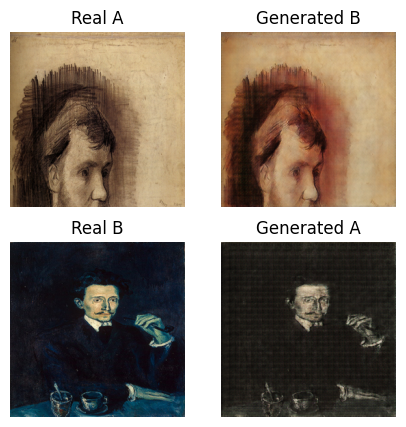

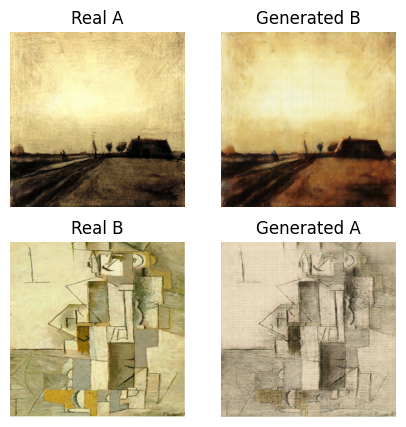

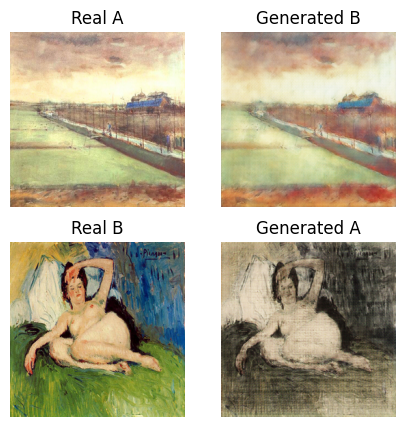

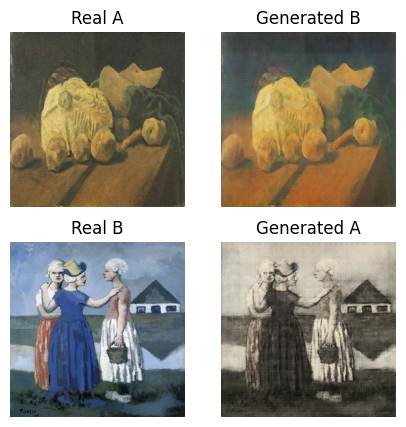

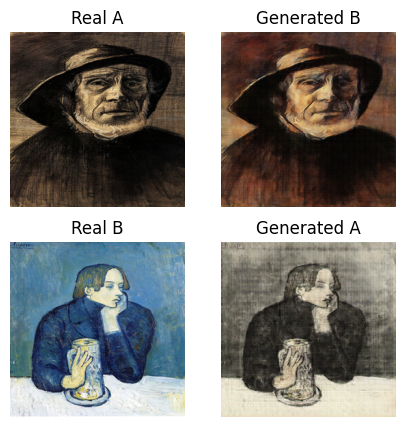

...

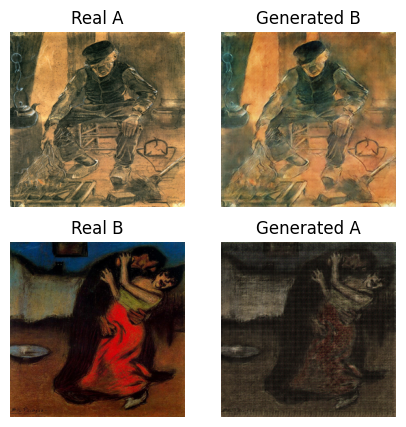

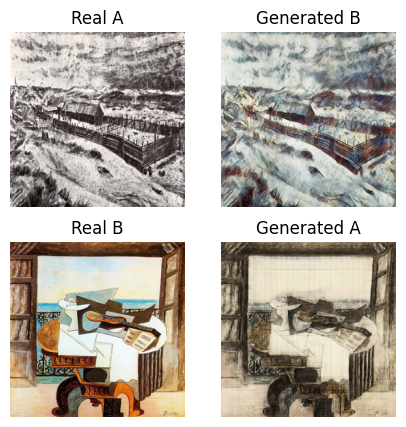

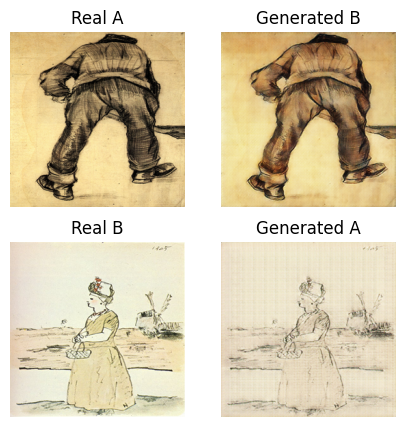

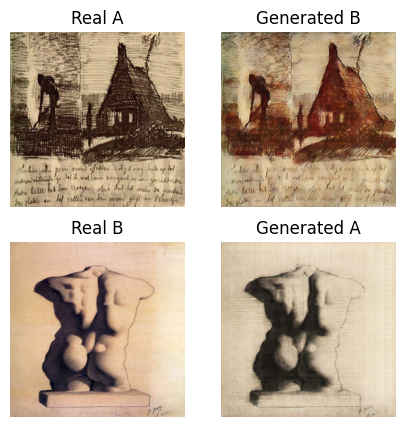

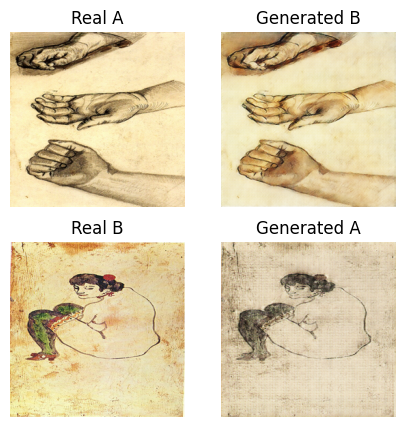

In [ ]:
import tensorflow as tf

print("***** ArtGAN Images *****")

# Convert test datasets to TensorFlow datasets (take the first 50 images)
test_A = tf.data.Dataset.from_tensor_slices(vg_test).take(50).batch(1)
test_B = tf.data.Dataset.from_tensor_slices(p_test).take(50).batch(1)

# Test the model on the withheld dataset
for real_A, real_B in zip(test_A, test_B):
    generated_B = g_AB(real_A, training=False)
    generated_A = g_BA(real_B, training=False)
    display_images(real_A, generated_B, real_B, generated_A)

### CycleGAN Evaluation

***** CycleGAN Images *****


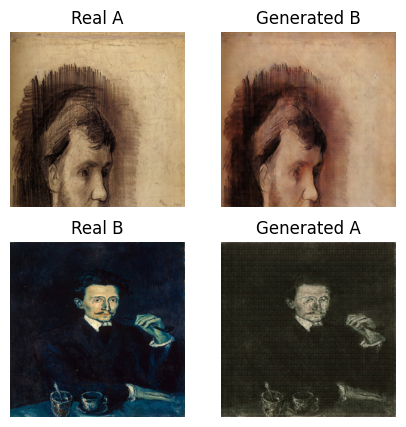

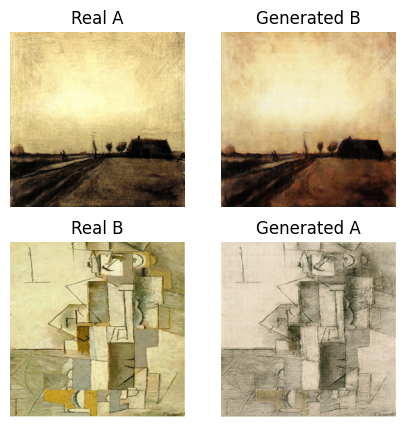

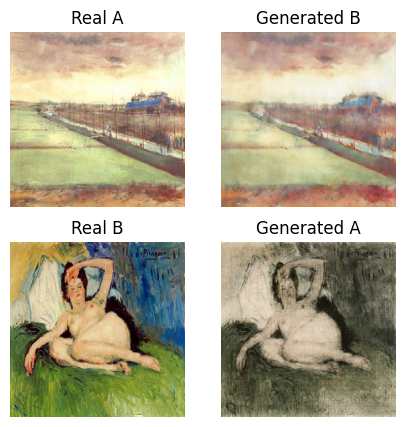

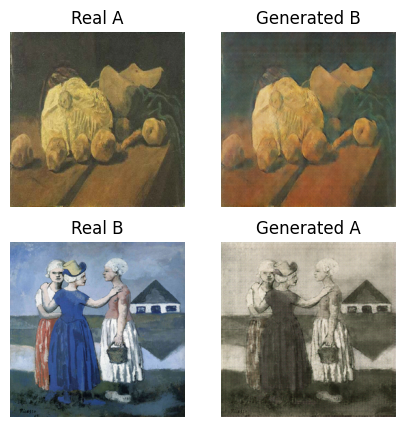

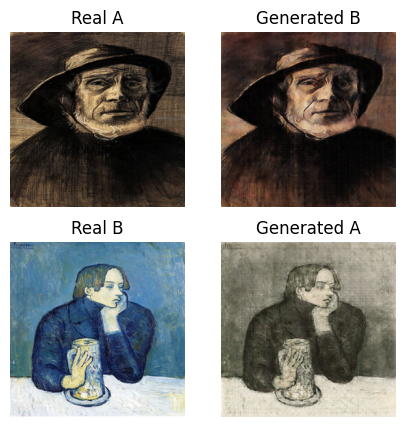

...

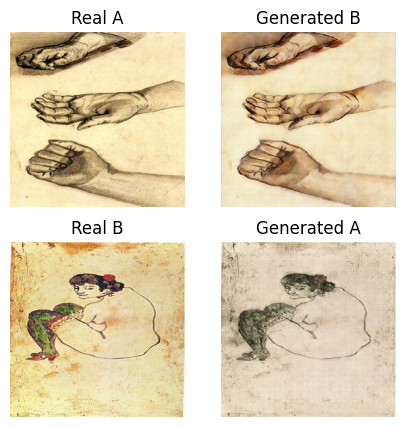

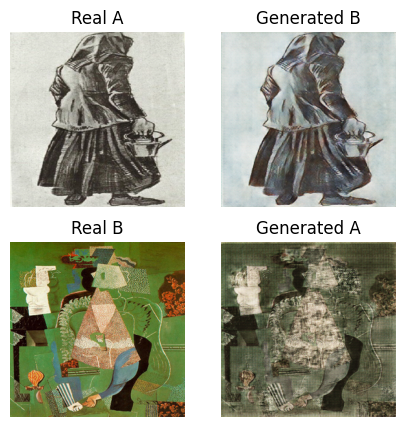

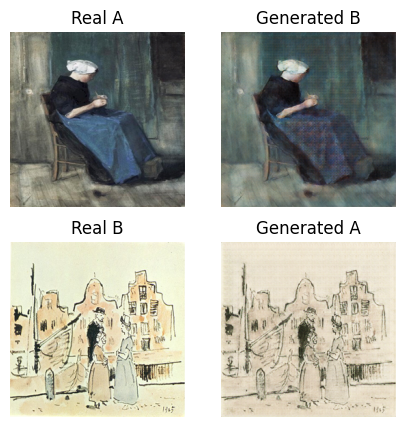

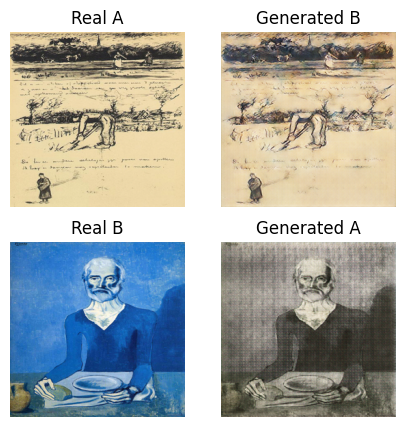

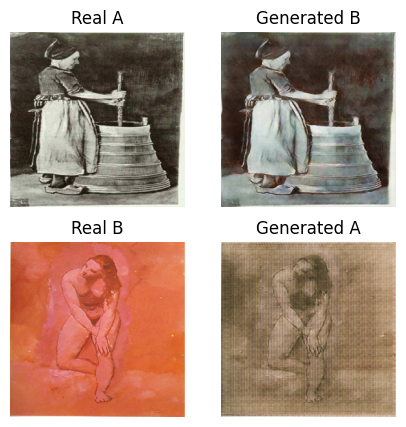

In [ ]:
print("***** CycleGAN Images *****")

# Convert test datasets to TensorFlow datasets (take the first 50 images)
test_A = tf.data.Dataset.from_tensor_slices(vg_test).take(50).batch(1)
test_B = tf.data.Dataset.from_tensor_slices(p_test).take(50).batch(1)

# Test the model on the withheld dataset
for real_A, real_B in zip(test_A, test_B):
    generated_B = g_AB_n(real_A, training=False)
    generated_A = g_BA_n(real_B, training=False)
    display_images(real_A, generated_B, real_B, generated_A)